#DCGAN

## Importing Libraries

In [1]:
!pip install datasets torchsummary -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 MB 25.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 11.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 22.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.0/172.0 kB 20.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 58.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.5/239.5 kB 24.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.3/124.3 kB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 301.6/301.6 kB 25.6 MB/s eta 0:00:00


In [2]:
import torch
import torch.nn as nn
from torchvision import transforms
from torch.utils.data import Dataset,DataLoader
import torchvision.utils as vutils
import torchvision
from torchvision import models

from tqdm import tqdm
from typing import Literal
import os

## Config

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [60]:
os.chdir('/content/drive/MyDrive')

In [5]:
class TrainingConfig():
  img_size = 64
  input_channels = 3
  latent_vector_size = 100
  gen_feature_size = 64
  dis_feature_size = 64
  batch_size = 64
  beta1 = 0.5
  learning_rate = 2e-4
  # gradient_accumulation_steps = 1
  model_checkpoint_epochs = 10
  save_image_epochs = 1
  # lr_warmup_steps = 500
  # max_grad_norm = 0.3
  device = 'cuda' if torch.cuda.is_available() else 'cpu'
  logging_steps = 247
  real_label = 0.0
  fake_label = 1.0

  output_dir = 'GANs/DCGAN'
  seed = 69

config = TrainingConfig()

In [61]:
main_directory = os.path.join(os.getcwd(),config.output_dir)
if not os.path.exists(main_directory):
  os.makedirs(main_directory)
os.chdir(main_directory)

## Cat Faces Dataset

In [7]:
from google.colab import userdata
import os

os.environ["KAGGLE_KEY"] = userdata.get('KAGGLE_KEY')
os.environ["KAGGLE_USERNAME"] = userdata.get('KAGGLE_USERNAME')

In [37]:
dataset_dir = os.path.join(os.getcwd(),'cats')
if not os.path.exists(dataset_dir):
  !kaggle datasets download -d spandan2/cats-faces-64x64-for-generative-models
  !unzip -qq 'cats-faces-64x64-for-generative-models.zip'

Dataset URL: https://www.kaggle.com/datasets/spandan2/cats-faces-64x64-for-generative-models
License(s): unknown
 93% 89.0M/96.0M [00:01<00:00, 59.8MB/s]
100% 96.0M/96.0M [00:01<00:00, 74.3MB/s]


In [33]:
image_transforms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((config.img_size,config.img_size)),
])

In [78]:
import cv2,os
import matplotlib.pyplot as plt

class DatasetGAN():
  def __init__(self,dir,image_transforms = image_transforms):
    self.dir = dir
    self.listdir = os.listdir(self.dir)
    self.transforms = image_transforms

  def __len__(self):
    return len(self.listdir)

  def __getitem__(self,idx):
    image = plt.imread(os.path.join(self.dir,self.listdir[idx]))
    if self.transforms:
      image = self.transforms(image)
    return image

In [79]:
dir = os.path.join(os.getcwd(),'cats')
Dataset = DatasetGAN(dir)

In [80]:
dataloader = DataLoader(Dataset,batch_size = config.batch_size,shuffle = True)

## Visualization

In [52]:
def find_opt_grid(x):
    # Initialize variables to store the optimal pair and the minimum difference
    optimal_a, optimal_b = None, None
    min_diff = float('inf')

    # Iterate over possible factors
    for a in range(1, int(x**0.5) + 1):
        if x % a == 0:
            b = x // a
            diff = abs(b - a)
            if diff < min_diff:
                min_diff = diff
                optimal_a, optimal_b = a, b

    return optimal_a, optimal_b

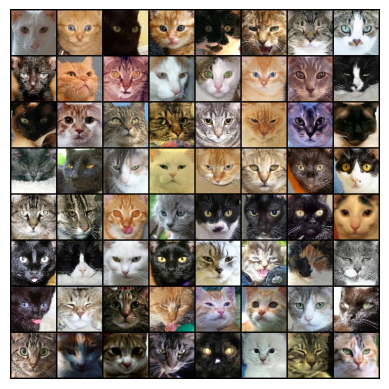

In [56]:
import matplotlib.pyplot as plt

a,b = find_opt_grid(config.batch_size)

for batch in dataloader:
  images = batch
  fig,ax = plt.subplots()
  ax.imshow(vutils.make_grid(images, nrow = a,padding=2, normalize=True,scale_each=True).permute((1,2,0)))
  ax.axis('off')
  fig.show()
  break

## Model

In [15]:
from torchsummary import summary

In [16]:
class Generator(nn.Module):
    def __init__(self, config):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( config.latent_vector_size, config.gen_feature_size * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(config.gen_feature_size * 8),
            nn.ReLU(True),
            # state size. ``(config.gen_feature_size*8) x 4 x 4``
            nn.ConvTranspose2d(config.gen_feature_size * 8, config.gen_feature_size * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(config.gen_feature_size * 4),
            nn.ReLU(True),
            # state size. ``(config.gen_feature_size*4) x 8 x 8``
            nn.ConvTranspose2d( config.gen_feature_size * 4, config.gen_feature_size * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(config.gen_feature_size * 2),
            nn.ReLU(True),
            # state size. ``(config.gen_feature_size*2) x 16 x 16``
            nn.ConvTranspose2d( config.gen_feature_size * 2, config.gen_feature_size, 4, 2, 1, bias=False),
            nn.BatchNorm2d(config.gen_feature_size),
            nn.ReLU(True),
            # state size. ``(config.gen_feature_size) x 32 x 32``
            nn.ConvTranspose2d( config.gen_feature_size, config.input_channels, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [17]:
summary(Generator(config),(100,1,1),device='cpu')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,200
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,072
             Tanh-14            [-1, 3,

In [18]:
class Discriminator(nn.Module):
    def __init__(self, config):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(config.input_channels, config.dis_feature_size, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(config.dis_feature_size) x 32 x 32``
            nn.Conv2d(config.dis_feature_size, config.dis_feature_size * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(config.dis_feature_size * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(config.dis_feature_size*2) x 16 x 16``
            nn.Conv2d(config.dis_feature_size * 2, config.dis_feature_size * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(config.dis_feature_size * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(config.dis_feature_size*4) x 8 x 8``
            nn.Conv2d(config.dis_feature_size * 4, config.dis_feature_size * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(config.dis_feature_size * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(config.dis_feature_size*8) x 4 x 4``
            nn.Conv2d(config.dis_feature_size * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [19]:
summary(Discriminator(config),(3,64,64),device='cpu')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,072
         LeakyReLU-2           [-1, 64, 32, 32]               0
            Conv2d-3          [-1, 128, 16, 16]         131,072
       BatchNorm2d-4          [-1, 128, 16, 16]             256
         LeakyReLU-5          [-1, 128, 16, 16]               0
            Conv2d-6            [-1, 256, 8, 8]         524,288
       BatchNorm2d-7            [-1, 256, 8, 8]             512
         LeakyReLU-8            [-1, 256, 8, 8]               0
            Conv2d-9            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-10            [-1, 512, 4, 4]           1,024
        LeakyReLU-11            [-1, 512, 4, 4]               0
           Conv2d-12              [-1, 1, 1, 1]           8,192
          Sigmoid-13              [-1, 1, 1, 1]               0
Total params: 2,765,568
Trainable param

## Training Setup

In [20]:
from torch.optim import Adam
import numpy as np
import pandas as pd

class DCGAN():
  def __init__(self,config,dataloader):
    super(DCGAN,self).__init__()
    self.generator = Generator(config).to(config.device)
    self.discriminator = Discriminator(config).to(config.device)

   # custom weights initialization with normal distributed weights (0,0.02)
    self.weights_init(self.generator)
    self.weights_init(self.discriminator)

    self.dataloader = dataloader
    self.len_loader = len(dataloader)

    self.config = config

    self.dis_optimizer = Adam(self.discriminator.parameters(),lr = config.learning_rate,betas = (config.beta1,0.999))
    self.gen_optimizer = Adam(self.generator.parameters(),lr = config.learning_rate,betas = (config.beta1,0.999))

    self.criterion = nn.BCELoss()

    self.gen = torch.Generator(device = config.device)
    self.gen.manual_seed(config.seed)

    self.logs = pd.DataFrame({'batch':[],'epoch':[],'loss_D':[],'loss_G':[],'D_x':[],'D_G_z1':[],'D_G_z2':[]})
    self.logs_len = 0

  def weights_init(self,m):
      classname = m.__class__.__name__
      if classname.find('Conv') != -1:
          nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif classname.find('BatchNorm') != -1:
          nn.init.normal_(m.weight.data, 1.0, 0.02)
          nn.init.constant_(m.bias.data, 0)

  def save_samples(self):
    with torch.no_grad():
      input = torch.randn((config.batch_size,config.latent_vector_size,1,1),device = config.device,generator = self.gen)
      out = self.generator(input)
      fig,ax = plt.subplots(1,1)
      nrow,ncol = find_opt_grid(self.config.batch_size)
      ax.imshow(vutils.make_grid(out.detach().cpu(), nrow = min(nrow,ncol),padding=2, normalize=True, scale_each = True).permute((1,2,0)))
      ax.axis('off');
      fig.tight_layout();
    return fig

  def FakeStep(self):
    self.dis_optimizer.zero_grad()

    input = torch.randn((config.batch_size,config.latent_vector_size,1,1),device = config.device)
    fake = self.generator(input)
    out = self.discriminator(fake.detach()).view(-1)
    D_G_z1 = out.mean().item()
    loss_D = self.criterion(out,torch.full(out.shape, config.fake_label, dtype=torch.float, device=config.device))

    loss_D.backward()
    self.dis_optimizer.step()

    self.gen_optimizer.zero_grad()
    out  = self.discriminator(fake).view(-1)
    D_G_z2 = out.mean().item()
    loss_G = self.criterion(out,torch.full(out.shape, config.real_label, dtype=torch.float, device=config.device))

    loss_G.backward()
    self.gen_optimizer.step()

    return loss_D.item(),loss_G.item(),D_G_z1,D_G_z2

  def RealStep(self,images):
    self.dis_optimizer.zero_grad()

    images = images.to(self.config.device)
    out = self.discriminator(images).view(-1)
    loss = self.criterion(out,torch.full(out.shape, config.real_label, dtype=torch.float, device=config.device))

    loss.backward()
    self.dis_optimizer.step()

    D_x = out.mean().item()

    return loss.item(),D_x

  def Train(self,epochs):
    try:
      start_epoch = self.config.epochs_trained
    except AttributeError:
      start_epoch = 0
    end_epoch = start_epoch + epochs
    self.config.epochs_trained = start_epoch

    self.generator.train()
    self.discriminator.train()

    for epoch in range(start_epoch,end_epoch):

      for i,batch in enumerate(self.dataloader):
        loss_DR,D_x = self.RealStep(batch)
        loss_DF,loss_G,D_G_z1,D_G_z2 = self.FakeStep()
        loss_D = loss_DF + loss_DR

        self.logs.loc[self.logs_len] = [i + self.len_loader*epoch,epoch,loss_D,loss_G,D_x, D_G_z1, D_G_z2]
        self.logs_len += 1

        if config.logging_steps is not None and (self.len_loader*epoch + i + 1)%config.logging_steps == 0:
          print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'% (epoch, end_epoch, i, self.len_loader,loss_D, loss_G, D_x, D_G_z1, D_G_z2))

      if (epoch + 1)%config.model_checkpoint_epochs == 0:

        directory = os.path.join(os.getcwd(),'checkpoints')
        if not os.path.exists(directory):
            os.makedirs('checkpoints')
        torch.save(self.generator,os.path.join(directory,f'generator_{epoch}.pt'))

      if (epoch + 1)%config.save_image_epochs == 0:
        fig = self.save_samples();
        directory = os.path.join(os.getcwd(),'samples')

        # Create the directory if it does not exist
        if not os.path.exists(directory):
            os.makedirs('samples')
        fig.savefig(os.path.join(directory, f'sample_{epoch}.png'));
        plt.close(fig);

      self.config.epochs_trained += 1

## Training

In [82]:
trainer = DCGAN(config,dataloader)

In [83]:
trainer.Train(epochs = 30)

[103/133][246/247]	Loss_D: 0.3348	Loss_G: 9.7393	D(x): 0.0029	D(G(z)): 0.7646 / 0.9996
[104/133][246/247]	Loss_D: 0.2941	Loss_G: 6.6433	D(x): 0.0166	D(G(z)): 0.7814 / 0.9970
[105/133][246/247]	Loss_D: 1.2196	Loss_G: 6.0963	D(x): 0.3259	D(G(z)): 0.6980 / 0.9939
[106/133][246/247]	Loss_D: 6.4457	Loss_G: 11.1534	D(x): 0.5742	D(G(z)): 0.0165 / 0.9987
[107/133][246/247]	Loss_D: 1.3343	Loss_G: 8.8429	D(x): 0.3032	D(G(z)): 0.5693 / 0.9993
[108/133][246/247]	Loss_D: 0.3610	Loss_G: 7.0130	D(x): 0.0290	D(G(z)): 0.7382 / 0.9986
[109/133][246/247]	Loss_D: 0.5616	Loss_G: 7.5319	D(x): 0.0371	D(G(z)): 0.6437 / 0.9986
[110/133][246/247]	Loss_D: 5.6380	Loss_G: 3.2461	D(x): 0.9954	D(G(z)): 0.9458 / 0.9028
[111/133][246/247]	Loss_D: 0.3843	Loss_G: 4.0353	D(x): 0.1621	D(G(z)): 0.8504 / 0.9665
[112/133][246/247]	Loss_D: 0.5012	Loss_G: 4.4248	D(x): 0.3391	D(G(z)): 0.9353 / 0.9603
[113/133][246/247]	Loss_D: 0.1707	Loss_G: 4.1907	D(x): 0.1127	D(G(z)): 0.9582 / 0.9740
[114/133][246/247]	Loss_D: 0.1320	Loss_G: 

In [84]:
config.model_checkpoint_epochs = 5
trainer.Train(epochs = 30)

[133/163][246/247]	Loss_D: 10.9817	Loss_G: 15.7673	D(x): 0.9709	D(G(z)): 0.0156 / 0.9999
[134/163][246/247]	Loss_D: 0.0086	Loss_G: 5.7819	D(x): 0.0020	D(G(z)): 0.9935 / 0.9941
[135/163][246/247]	Loss_D: 3.1107	Loss_G: 12.7209	D(x): 0.5717	D(G(z)): 0.2306 / 0.9998
[136/163][246/247]	Loss_D: 0.0133	Loss_G: 7.6110	D(x): 0.0108	D(G(z)): 0.9976 / 0.9983
[137/163][246/247]	Loss_D: 5.0639	Loss_G: 19.5475	D(x): 0.8893	D(G(z)): 0.1578 / 1.0000
[138/163][246/247]	Loss_D: 0.3566	Loss_G: 5.7213	D(x): 0.2241	D(G(z)): 0.9892 / 0.9736
[139/163][246/247]	Loss_D: 0.0045	Loss_G: 7.5017	D(x): 0.0028	D(G(z)): 0.9983 / 0.9985
[140/163][246/247]	Loss_D: 0.0042	Loss_G: 9.5995	D(x): 0.0039	D(G(z)): 0.9997 / 0.9998
[141/163][246/247]	Loss_D: 0.0404	Loss_G: 5.4896	D(x): 0.0165	D(G(z)): 0.9777 / 0.9913
[142/163][246/247]	Loss_D: 4.6317	Loss_G: 31.2554	D(x): 0.5127	D(G(z)): 0.1666 / 0.9999
[143/163][246/247]	Loss_D: 3.9183	Loss_G: 6.9613	D(x): 0.8590	D(G(z)): 0.5891 / 0.9955
[144/163][246/247]	Loss_D: 0.0297	Loss

## Results

In [ ]:
import plotly.graph_objects as go

def plot_results(trainer,plot_type: Literal['per_batch','per_epoch']):
  if plot_type not in ['per_batch','per_epoch']:
      raise ValueError(f"Invalid plot_type: {plot_type}")

  fig = go.Figure()
  if plot_type == 'per_batch':
    fig.add_trace(go.Scatter(y = trainer.logs['loss_D'], name='Loss_D'))
    fig.add_trace(go.Scatter(y = trainer.logs['loss_G'], name='Loss_G'))

  else:
    fig.add_trace(go.Scatter(y =trainer.logs.groupby('epoch')['loss_D'].mean(), name='Loss_D'))
    fig.add_trace(go.Scatter(y = trainer.logs.groupby('epoch')['loss_G'].mean(), name='Loss_G'))

  fig.update_layout(
      title_text="Loss " + plot_type,
      # width = size[1],
      # height = size[0]
  )

  return fig

In [86]:
plot_results(trainer,plot_type= 'per_batch')

In [87]:
plot_results(trainer,plot_type= 'per_epoch')

## Samples Visulaization

In [88]:
import re

samples_dir = os.getcwd() + '/' + 'samples'

file_list = os.listdir(samples_dir)

def extract_number(filename):
    match = re.search(r'\d+', filename)
    return int(match.group()) if match else -1

sorted_paths = sorted(file_list, key=extract_number)

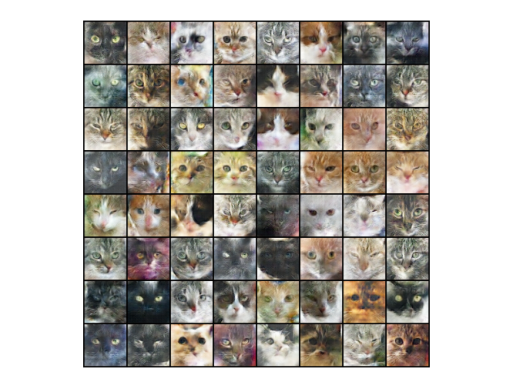

In [89]:
import matplotlib.pyplot as plt
from IPython.display import HTML
from matplotlib.animation import ArtistAnimation,FFMpegWriter

# Set up the figure and axis
fig, ax = plt.subplots()
plt.axis("off")
ims = []
for filename in sorted_paths:
    im = plt.imread(os.path.join(samples_dir, filename))
    ims.append([plt.imshow(im, animated=True)])

ani = ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [90]:
ani.save(os.getcwd() + '/' + 'anim.mp4')

## Inference

In [ ]:
# best_checkpoint_epoch = 49
# gen_model = torch.load(os.getcwd() + '/' + 'checkpoints' + '/' + f'generator_{best_checkpoint_epoch}.pt')

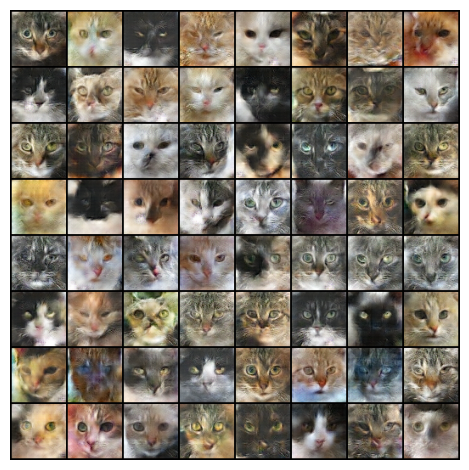

In [92]:
with torch.no_grad():
      input = torch.randn((config.batch_size,config.latent_vector_size,1,1),device = config.device)
      out = trainer.generator(input)
      fig,ax = plt.subplots(1,1)
      ax.imshow(vutils.make_grid(out.detach().cpu(), nrow = 8,padding=2, normalize=True,scale_each = True).permute((1,2,0)))
      ax.axis('off');
      fig.tight_layout();
      fig.show();